In [ ]:
import os
import json
from PIL import Image
from torch.utils.data import Dataset
from transformers import PaliGemmaForConditionalGeneration , PaliGemmaProcessor
from huggingface_hub import login
import torch
login(token= "Enter Your Token Here")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
class JSONLDataset(Dataset):
    def __init__(self, jsonl_file_path: str, image_directory_path: str):
        self.jsonl_file_path = jsonl_file_path
        self.image_directory_path = image_directory_path
        self.entries = self._load_entries()

    def _load_entries(self):
        entries = []
        with open(self.jsonl_file_path, 'r') as file:
            for line in file:
                data = json.loads(line)
                entries.append(data)
        return entries

    def __len__(self):
        return len(self.entries)

    def __getitem__(self, idx: int):
        if idx < 0 or idx >= len(self.entries):
            raise IndexError("Index out of range")

        entry = self.entries[idx]
        image_path = os.path.join(self.image_directory_path, entry['image'])
        image = Image.open(image_path)
        return image, entry

In [ ]:
train_dataset = JSONLDataset(
    jsonl_file_path="/content/drive/MyDrive/train/annotations.jsonl",
    image_directory_path="/content/drive/MyDrive/train"
)

In [ ]:
from torch.utils.data import DataLoader

In [ ]:
MODEL_ID = "google/paligemma2-3b-pt-448"
processor = PaliGemmaProcessor.from_pretrained(MODEL_ID)

preprocessor_config.json:   0%|          | 0.00/425 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/243k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/34.6M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

In [ ]:
train_dataloader = DataLoader(train_dataset, collate_fn = collate_fn, batch_size =2, shuffle = True)

In [ ]:
batch = next(iter(train_dataloader))

In [ ]:
batch

{'input_ids': tensor([[257152, 257152, 257152,  ..., 235308,    633,  12990],
        [     0,      0,      0,  ..., 235284,    640,  12990]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'pixel_values': tensor([[[[1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          ...,
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.]],

         [[1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          ...,
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.]],

         [[1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],


In [ ]:
input_ids = batch['input_ids']

In [ ]:
pixel_values = batch['pixel_values']

In [ ]:
pixel_values

tensor([[[[ 1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,  1.0000,
            1.0000,  1.0000,  1.0000, 

In [ ]:
torch.set_printoptions(profile="full")
print(input_ids)

tensor([[257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152, 257152,
         257152, 257152, 257

In [ ]:
processor.batch_decode(input_ids)

['<image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><image><ima

In [ ]:
!pip install -q peft bitsandbytes transformers>=4.47.0

In [ ]:
import torch
from peft import get_peft_model, LoraConfig
from transformers import PaliGemmaProcessor, PaliGemmaForConditionalGeneration, BitsAndBytesConfig
from huggingface_hub import login
login(token= "Your_token")

MODEL_ID ="google/paligemma2-3b-pt-448"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

processor = PaliGemmaProcessor.from_pretrained(MODEL_ID)
USE_LORA = True
USE_QLORA = False
FREEZE_VISION = False

if USE_LORA or USE_QLORA:
    lora_config = LoraConfig(
    r=8,
    target_modules=[
        "q_proj",
        "o_proj",
        "k_proj",
        "v_proj",
        "gate_proj",
        "up_proj",
        "down_proj"
    ],
    task_type="CAUSAL_LM",
    )
    if USE_QLORA:
        bnb_config = BitsAndBytesConfig(
        load_in_4bit=True,
        bnb_4bit_quant_type="nf4",
        bnb_4bit_compute_type=torch.bfloat16
            )
    model = PaliGemmaForConditionalGeneration.from_pretrained(
        MODEL_ID,
        device_map="auto",
        quantization_config=bnb_config if USE_QLORA else None,
        torch_dtype=torch.bfloat16)
    model = get_peft_model(model, lora_config)
    model = model.to(DEVICE)
    model.print_trainable_parameters()
else:
    model = PaliGemmaForConditionalGeneration.from_pretrained(
        MODEL_ID, device_map="auto").to(DEVICE)
    model = model.to(DEVICE)

    # if FREEZE_VISION:
    #     for param in model.vision_tower.parameters():
    #         param.requires_grad = False

    #     for param in model.multi_modal_projector.parameters():
    #         param.requires_grad = False

TORCH_DTYPE = model.dtype

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/425 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/243k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/34.6M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/75.1k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/1.07G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/173 [00:00<?, ?B/s]

trainable params: 11,876,352 || all params: 3,045,003,504 || trainable%: 0.3900


In [ ]:
from transformers import Trainer, TrainingArguments


def collate_fn(batch):
    images, labels = zip(*batch)

    paths = [label["image"] for label in labels]
    prefixes = ["<image>extract data in JSON format" for label in labels]
    suffixes = [label["suffix"] for label in labels]

    inputs = processor(
        text=prefixes,
        images=images,
        return_tensors="pt",
        suffix=suffixes,
        padding="longest"
    ).to(DEVICE)

    return inputs

In [ ]:
train_dataset[1]

(<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1275x1650>,
 {'image': 'IMG_03_JPG.jpg',
  'prefix': '<JSON>',
  'suffix': '{"patient_header":[{"type":"Consultation summary","Patient_MRN":"10120401727600","Consultation_Date":"15/12/2023 09:30 AM","Patient Name":"Mrs Sarah Johnson","Consultation":"Dr. Marcus Chen","Gender/Age/Dob":"Female, 45 Years, 22/03/78","Consultation Type":"OP","Patient Phone No":"8845667133","Patient Address":"123 Maple Street, Boston, MA"}],"patient_body":[{"CHIEF COMPLAINTS & HISTORY OF PRESENT ILLNESS":"Pt complains of severe tooth sensitivity pain while drinking hot beverages bleeding gums during brushing","ALLERGY":"Allergy to penicillin","VITALS":"Fall Score: Low Risk","Pain Score":"6 (TOOTH)","EXAMINATION":"Cavity detected in upper right molar Mild gingivitis present Sensitivity test positive for tooth #18","ADVICE":"Regular warm salt water gargling Soft bristle toothbrush recommended"}],"Medication_order":{"DRUG_NAME":[{"1":"IBUPROFEN-TABLET-400MG

In [ ]:

args = TrainingArguments(
    num_train_epochs=50,
    remove_unused_columns=False,
    per_device_train_batch_size=1,
    gradient_accumulation_steps=8,
    warmup_steps=2,
    learning_rate=1e-6,
    weight_decay=1e-6,
    adam_beta2=0.999,
    logging_steps=20,
    optim="paged_adamw_8bit" if USE_QLORA else "adamw_hf",
    save_strategy="steps",
    save_steps=1000,
    save_total_limit=1,
    output_dir="/content/paligemma_output",
    bf16=True,
    report_to=["tensorboard"],
    dataloader_pin_memory=False
)

In [ ]:
trainer = Trainer(
    model=model,
    train_dataset=train_dataset,
    data_collator=collate_fn,
    args=args
)
trainer.train()

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss
20,0.000400
40,0.000400
60,0.000400
80,0.000400
100,0.000400
120,0.000400
140,0.000400


TrainOutput(global_step=150, training_loss=0.00038159560567388933, metrics={'train_runtime': 574.073, 'train_samples_per_second': 2.526, 'train_steps_per_second': 0.261, 'total_flos': 2.567359003599965e+16, 'train_loss': 0.00038159560567388933, 'epoch': 41.37931034482759})

In [ ]:
#0.000400

device(type='cuda')

In [ ]:
image, label = train_dataset[1]


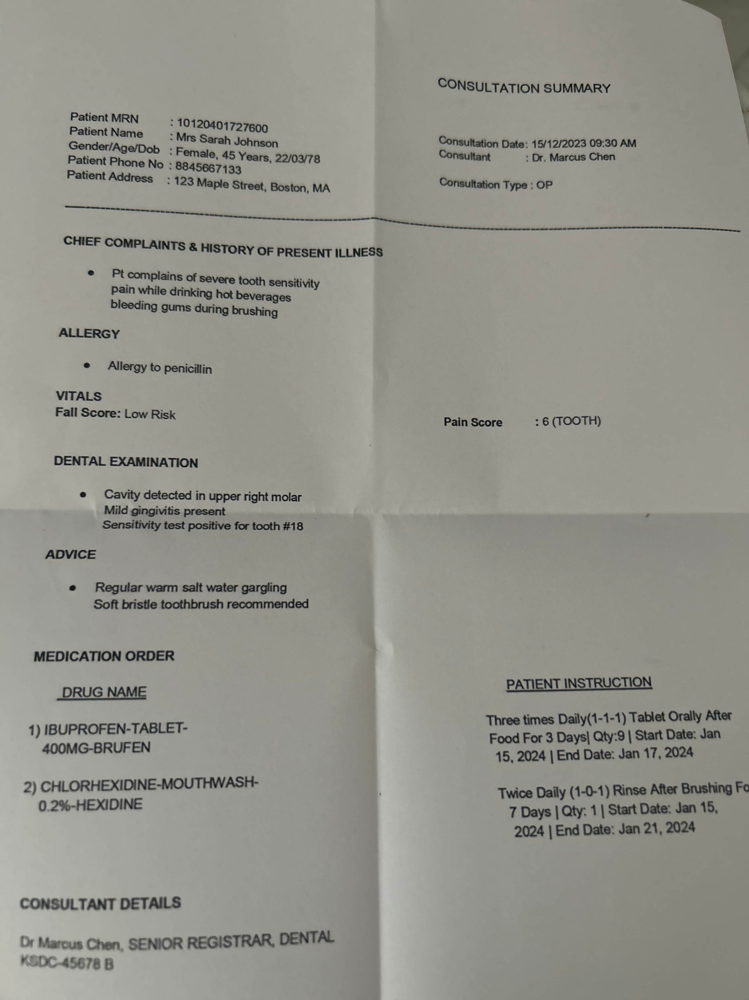

In [ ]:
image

In [ ]:
image, label = train_dataset[3]
prefix = "<image>extract data in JSON format"
suffix = label["suffix"]

inputs = processor(
    text=prefix,
    images=image,
    return_tensors="pt"
).to(TORCH_DTYPE).to(DEVICE)

# Calculate the length of the input sequence
prefix_length = inputs["input_ids"].shape[-1]

with torch.inference_mode():
    generation = model.generate(
        **inputs, max_new_tokens=600, do_sample=False)

    # Extract only the generated tokens by slicing the sequence
    generation = generation[0][prefix_length:]

    decoded = processor.decode(
        generation, skip_special_tokens=True)

    print(json.dumps(json.loads(decoded), indent=4))

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

In [ ]:
label

{'image': 'IMG_03_JPG.jpg',
 'prefix': '<JSON>',
 'suffix': '{"patient_header":[{"type":"Consultation summary","Patient_MRN":"10120401727600","Consultation_Date":"15/12/2023 09:30 AM","Patient Name":"Mrs Sarah Johnson","Consultation":"Dr. Marcus Chen","Gender/Age/Dob":"Female, 45 Years, 22/03/78","Consultation Type":"OP","Patient Phone No":"8845667133","Patient Address":"123 Maple Street, Boston, MA"}],"patient_body":[{"CHIEF COMPLAINTS & HISTORY OF PRESENT ILLNESS":"Pt complains of severe tooth sensitivity pain while drinking hot beverages bleeding gums during brushing","ALLERGY":"Allergy to penicillin","VITALS":"Fall Score: Low Risk","Pain Score":"6 (TOOTH)","EXAMINATION":"Cavity detected in upper right molar Mild gingivitis present Sensitivity test positive for tooth #18","ADVICE":"Regular warm salt water gargling Soft bristle toothbrush recommended"}],"Medication_order":{"DRUG_NAME":[{"1":"IBUPROFEN-TABLET-400MG-BRUFEN","2":"CHLORHEXIDINE-MOUTHWASH-0.2%-HEXIDINE"}],"PATIENT_INSTRUC

In [ ]:
generation

tensor([  1547,   3718,    747,  55216,    568, 235269,   5824, 235248, 235304,
        235276, 235269, 235248, 235284, 235276, 235284, 235276,   6473,   4372,
        235248, 235284, 235276, 235284, 235274, 235290, 235274, 235284, 235290,
        235304, 235276, 187070,   1307, 235248, 235284, 235324, 235304, 235274,
        235284, 235276, 235284, 235276, 235290, 235284, 235310, 235292, 235274,
        235308,      1], device='cuda:0')

In [ ]:
login(token= "Enter your token here")
trainer.push_to_hub()

adapter_model.safetensors:   0%|          | 0.00/47.6M [00:00<?, ?B/s]

Upload 10 LFS files:   0%|          | 0/10 [00:00<?, ?it/s]

events.out.tfevents.1734510657.935525dadfac.4522.1:   0%|          | 0.00/5.84k [00:00<?, ?B/s]

events.out.tfevents.1734510590.935525dadfac.4522.0:   0%|          | 0.00/5.84k [00:00<?, ?B/s]

events.out.tfevents.1734510670.935525dadfac.4522.2:   0%|          | 0.00/6.19k [00:00<?, ?B/s]

events.out.tfevents.1734510794.935525dadfac.4522.3:   0%|          | 0.00/5.84k [00:00<?, ?B/s]

events.out.tfevents.1734510829.935525dadfac.4522.4:   0%|          | 0.00/5.84k [00:00<?, ?B/s]

events.out.tfevents.1734510859.935525dadfac.4522.5:   0%|          | 0.00/12.5k [00:00<?, ?B/s]

events.out.tfevents.1734513299.935525dadfac.4522.6:   0%|          | 0.00/12.5k [00:00<?, ?B/s]

events.out.tfevents.1734515856.935525dadfac.4522.7:   0%|          | 0.00/7.65k [00:00<?, ?B/s]

training_args.bin:   0%|          | 0.00/5.30k [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/mrinalmouza1984/paligemma_output/commit/eee54058111ea9a890991ff71a5d58d6cb6bb5ec', commit_message='End of training', commit_description='', oid='eee54058111ea9a890991ff71a5d58d6cb6bb5ec', pr_url=None, repo_url=RepoUrl('https://huggingface.co/mrinalmouza1984/paligemma_output', endpoint='https://huggingface.co', repo_type='model', repo_id='mrinalmouza1984/paligemma_output'), pr_revision=None, pr_num=None)

In [ ]:
from transformers import PaliGemmaForConditionalGeneration , PaliGemmaProcessor

In [ ]:
from huggingface_hub import login
login(token= "Enter Your token here")
model = PaliGemmaForConditionalGeneration.from_pretrained('mrinalmouza1984/paligemma_output')

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


adapter_config.json:   0%|          | 0.00/798 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.33k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/75.1k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/1.07G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/173 [00:00<?, ?B/s]

adapter_model.safetensors:   0%|          | 0.00/47.6M [00:00<?, ?B/s]

In [ ]:
MODEL_ID = "google/paligemma2-3b-pt-224"
processor = PaliGemmaProcessor.from_pretrained(MODEL_ID)

preprocessor_config.json:   0%|          | 0.00/424 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/243k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/34.6M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

In [ ]:
import torch
TORCH_DTYPE = model.dtype
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
model = model.to(DEVICE)

In [ ]:
image, label = train_dataset[5]

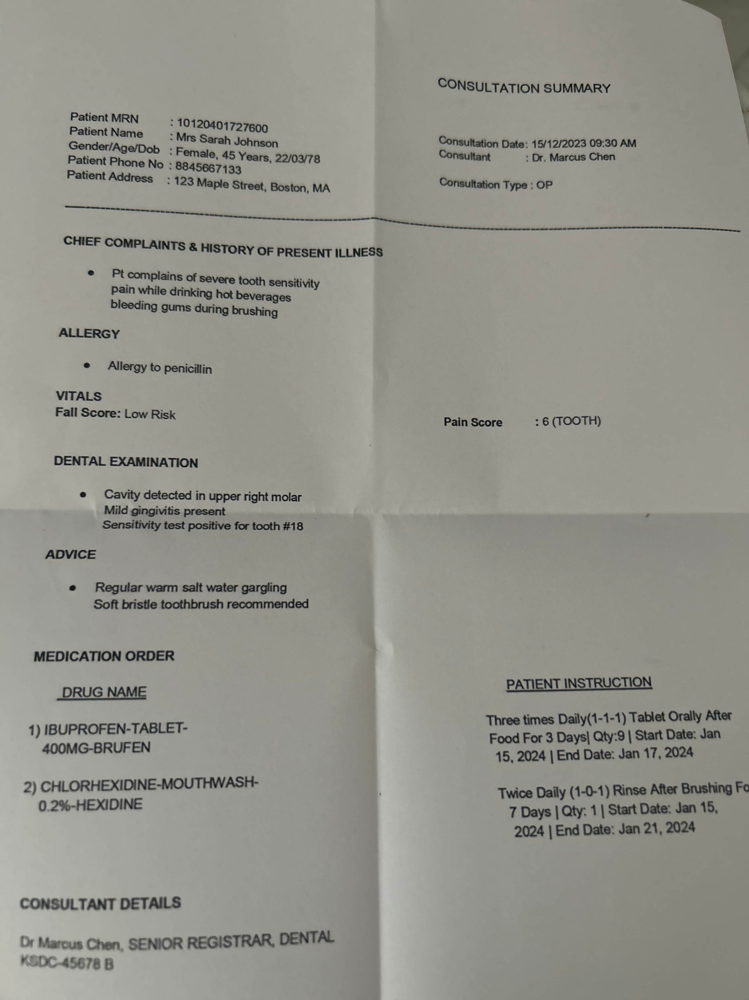

In [ ]:
image

In [ ]:
image, label = train_dataset[5]
prefix = "<image>extract data in JSON format"
suffix = label["suffix"]

inputs = processor(
    text=prefix,
    images=image,
    return_tensors="pt"
).to(TORCH_DTYPE).to(DEVICE)

# Calculate the length of the input sequence
prefix_length = inputs["input_ids"].shape[-1]

with torch.inference_mode():
    generation = model.generate(
        **inputs, max_new_tokens=410, do_sample=False)

    # Extract only the generated tokens by slicing the sequence
    generation = generation[0][prefix_length:]

    decoded = processor.decode(
        generation, skip_special_tokens=True)

The 'batch_size' attribute of HybridCache is deprecated and will be removed in v4.49. Use the more precisely named 'self.max_batch_size' attribute instead.


In [ ]:
decoded

'{"patient_header":[{"type":"Consultation summary","Patient_MRN":"10120401727600","Consultation_Date":"15/12/2023 09:30 AM","Patient Name":"Mrs Sarah Johnson","Consultation":"Dr. Marcus Chen","Gender/Age/Dob":"Female, 45 Years, 22/03/78","Consultation Type":"OP","Patient Phone No":"8845667133","Patient Address":"123 Willow Street, Boston, MA"}],"patient_body":[{"CHIEF COMPLAINTS & HISTORY OF PRESENT ILLNESS":"Pt complains of severe tooth sensitivity pain while drinking hot beverages bleeding gums during brushing","ALLERGY":"Allergy to penicillin","VITALS":"Fall Score: Low Risk","Pain Score":"6 (TOOTH)","EXAMINATION":"Cavity detected in upper right molar Mild gingivitis present Sensitivity test positive for tooth #18","ADVICE":"Regular warm salt water gargling Soft bristle toothbrush recommended"}],"Medication_order":{"DRUG_NAME":[{"1":"IBUPROFEN-TABLET-400MG-BRUFEN","2":"CHLORHEXIDINE-MOUTHWASH-0.2%-HEXIDINE"}],"PATIENT_INSTRUCTION":[{"1":"Three times Daily(1-1-1) Tablet Orally After F